In [6]:
import os
import sys
sys.path.append(os.path.dirname(os.getcwd()))

import numpy as np
import h5py
from scipy.stats import binned_statistic_2d
from math import ceil, sqrt
from itertools import permutations
import warnings
from scipy.ndimage import gaussian_filter
from sklearn.preprocessing import normalize
from scipy.io import loadmat
import matplotlib.pyplot as plt

try:
    from analysis.config import h5_path_dict
    from analysis.ExpData import ExpData
except:
    warnings.warn("Emily's experimental data could not be loaded.")

from sr_model.utils import pol2cart, downsample
from datasets import inputs
import configs

/var/folders/jf/2_wn4hjd11q9klftv_v_hld80000gn/T/ipykernel_54857/1714897130.py:20: UserWarning: Emily's experimental data could not be loaded.
  warnings.warn("Emily's experimental data could not be loaded.")


In [22]:
data_dir = f'{configs.engram_dir}payne_et_al_2021_data/'
titmouse_data = [f for f in os.listdir(data_dir) if f.startswith('HT')]

In [23]:
import pandas as pd
cm_to_bin = 5
fps = 3
num_steps = 6000 #np.inf
num_states = 14*14

# Trajectory plots in discretized space

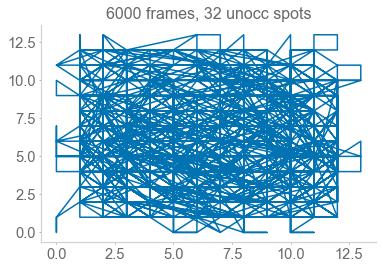

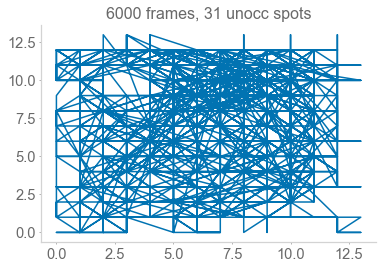

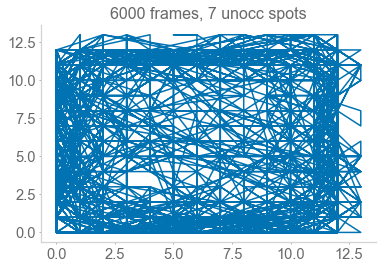

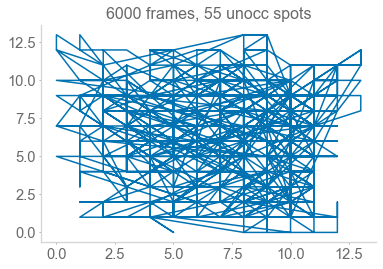

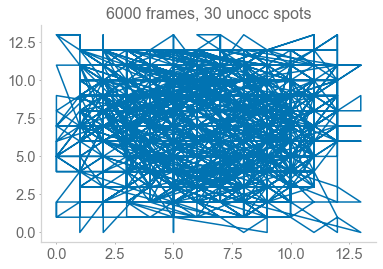

...

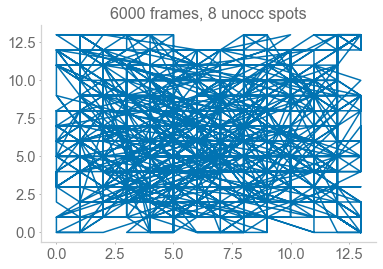

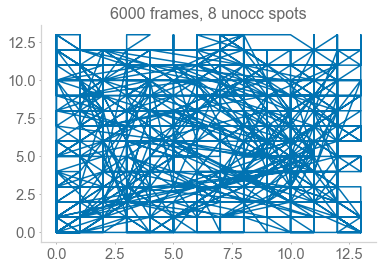

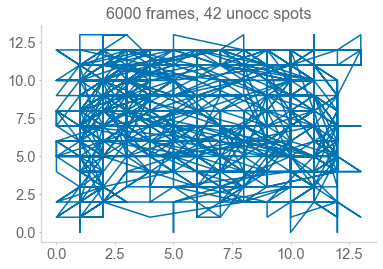

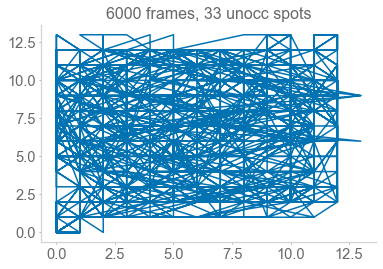

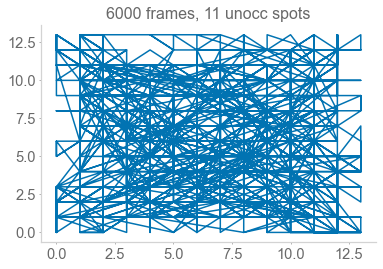

KeyboardInterrupt: 

In [10]:
exp_lens = []
n_unoccupied = []
for idx, session in enumerate(titmouse_data):
    path = data_dir + session
    data = loadmat(path)['B'][0,0]
    exp_fps = data[0][0,0]
    exp_xs = data[1].squeeze()
    exp_ys = data[2].squeeze()
    exp_xs = pd.Series(exp_xs).interpolate().ffill().bfill().to_numpy()
    exp_ys = pd.Series(exp_ys).interpolate().ffill().bfill().to_numpy()
    
    contin_xs = exp_xs[::int(exp_fps/fps)]
    contin_ys = exp_ys[::int(exp_fps/fps)]
    contin_xs -= contin_xs.min()
    contin_ys -= contin_ys.min()
    max_pixel = max(contin_xs.max(), contin_ys.max())
    contin_xs = (contin_xs/max_pixel)*69
    contin_ys = (contin_ys/max_pixel)*69
    num_states = int((70/cm_to_bin) ** 2)
    xs, ys, dg_inputs = get_onehot_states(contin_xs, contin_ys)
    
    exp_len = dg_inputs.shape[1]
    n_unocc = np.sum(np.sum(dg_inputs, axis=1) < 3)
    plt.figure()
    plt.plot(xs, ys)
    plt.title(f'{exp_len} frames, {n_unocc} unocc spots')
    plt.show()
    exp_lens.append(exp_len)
    n_unoccupied.append(n_unocc)
    

# Trajectory plots in continuous space

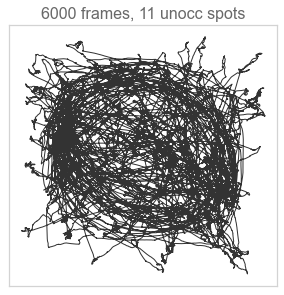

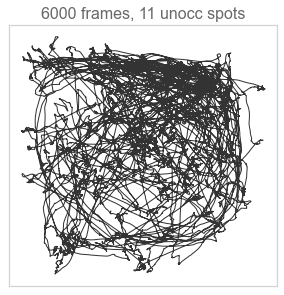

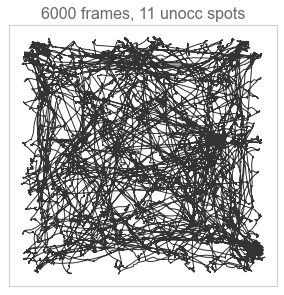

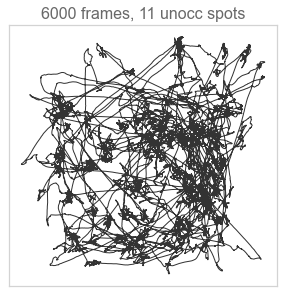

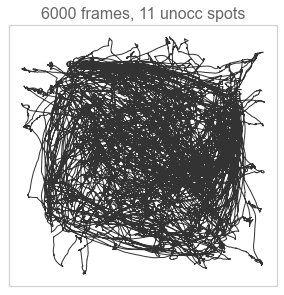

...

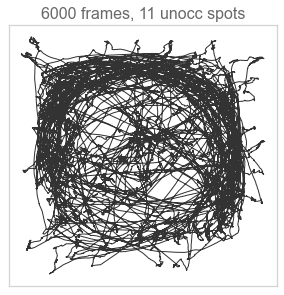

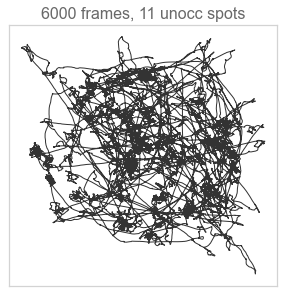

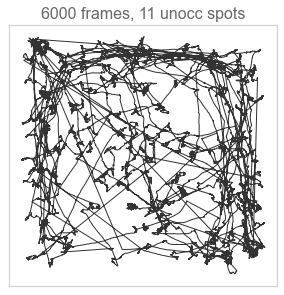

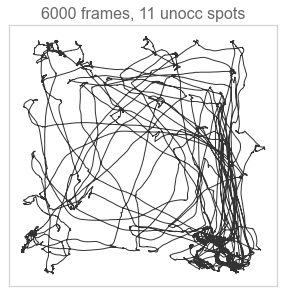

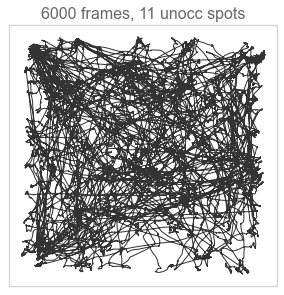

In [36]:
exp_lens = []
n_unoccupied = []
for idx, session in enumerate(titmouse_data):
    path = data_dir + session
    data = loadmat(path)['B'][0,0]
    exp_fps = data[0][0,0]
    exp_xs = data[1].squeeze()
    exp_ys = data[2].squeeze()
    exp_xs = pd.Series(exp_xs).interpolate().ffill().bfill().to_numpy()
    exp_ys = pd.Series(exp_ys).interpolate().ffill().bfill().to_numpy()
    
    exp_len = dg_inputs.shape[1]
    n_unocc = np.sum(np.sum(dg_inputs, axis=1) < 3)
    fig, ax = plt.subplots(figsize=(4.8, 4.8))
    ax.plot(
        exp_xs[:int(exp_fps*60*20)],
        exp_ys[:int(exp_fps*60*20)],
        color='black', linewidth=1., alpha=0.8
        )
    plt.title(f'{exp_len} frames, {n_unocc} unocc spots')
    plt.xticks([])
    plt.yticks([])
    ax.spines['top'].set_visible(True)
    ax.spines['right'].set_visible(True)
    plt.show()
    exp_lens.append(exp_len)
    n_unoccupied.append(n_unocc)

In [26]:
exp_fps

300.0017693000688

(array([0., 0., 0., 0., 0., 5., 0., 0., 0., 0.]),
 array([5999.5, 5999.6, 5999.7, 5999.8, 5999.9, 6000. , 6000.1, 6000.2,
        6000.3, 6000.4, 6000.5]),
 <BarContainer object of 10 artists>)

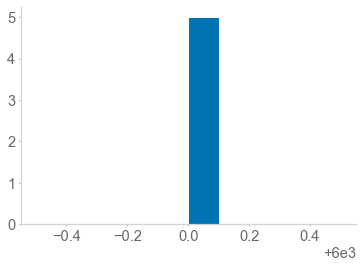

In [13]:
plt.hist(exp_lens)

(array([0., 0., 0., 0., 0., 1., 0., 0., 0., 0.]),
 array([10.5, 10.6, 10.7, 10.8, 10.9, 11. , 11.1, 11.2, 11.3, 11.4, 11.5]),
 <BarContainer object of 10 artists>)

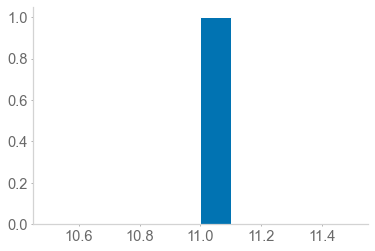

In [14]:
plt.hist(n_unoccupied, weights=[1/len(n_unoccupied)]*len(n_unoccupied))

In [15]:
np.sum(np.array(n_unoccupied) < 30)/len(n_unoccupied)

1.0

In [17]:
from datasets import inputs, sf_inputs_discrete 

In [18]:
dataset = sf_inputs_discrete.TitmouseWalk

In [19]:
feature_maker_kwargs = {                                                
    'feature_dim': num_states, 'feature_type': 'correlated_distributed',
    'feature_vals_p': [1-0.001, 0.001],                       
    'spatial_sigma': 0.
    }                                                                   
dataset_config = {                                                      
    'num_steps': 5001, 'feature_maker_kwargs': feature_maker_kwargs,
    'num_states': 14*14
    }  

In [20]:
dset = dataset(**dataset_config)

FileNotFoundError: [Errno 2] No such file or directory: '../../engram/Ching/payne_et_al_2021_data/'

In [21]:
for _ in range(10):
    dset = dataset(**dataset_config)
    plt.figure();
    plt.plot(dset.xs, dset.ys)
    plt.show()

FileNotFoundError: [Errno 2] No such file or directory: '../../engram/Ching/payne_et_al_2021_data/'